# Clusterização - Cartão de Crédito

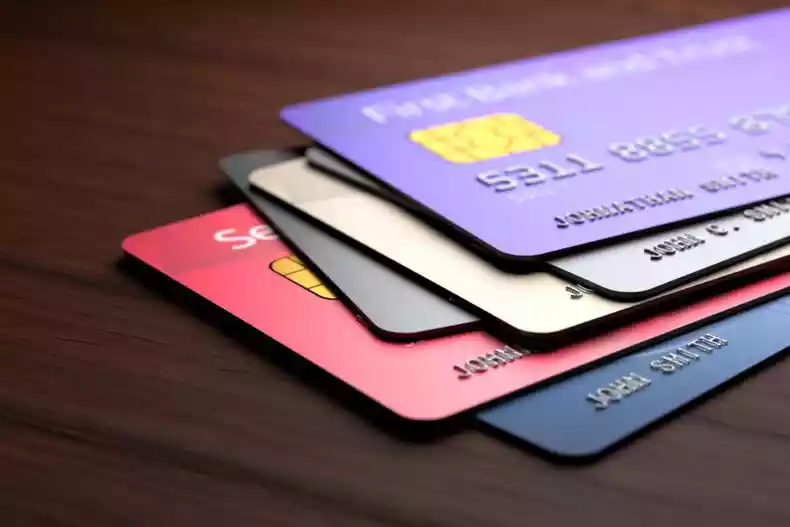
[fonte](https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.em.com.br%2Fapp%2Fcolunistas%2Fmeu-acerto%2F2022%2F03%2F30%2Fnoticia-meu-acerto%2C1356228%2Fpagar-boleto-com-cartao-de-credito-e-possivel-vale-a-pena.shtml&psig=AOvVaw2-ZjHYJbodkDg-n4qJM-4N&ust=1681497810436000&source=images&cd=vfe&ved=0CBMQjhxqFwoTCKDGrc_Bp_4CFQAAAAAdAAAAABAZ)

A Base de dados que será utilizada para este projeto se encontra disponível publicamente no [Kaggle](https://www.kaggle.com/datasets/arjunbhasin2013/ccdata).
Trata-se de uma amostra que resume o comportamento de uso de cerca de 9.000 titulares de cartão de crédito ativos durante os últimos 6 meses.
Nosso objetivo é fazer a segmentação de clientes e encontrar características que os definem para definir estratégias de marketing.

## Dicionário de dados


| Coluna  | Descrição |
| ------- | --------- |
| CUSTID     | Identificação do titular do cartão de crédito |
| BALANCE| Saldo do valor restante em sua conta para fazer compras |
| BALANCEFREQUENCY   | Com que frequência o Balanço é atualizado, pontuação entre 0 e 1 (1 = é atualizado com frequência, 0 = não é atualizado com frequência) |
| PURCHASES    | Quantidade de compras feitas na conta |
| ONEOFFPURCHASES | Valor máximo de compra feito de uma só vez |
| INSTALLMENTSPURCHASES | Valor da compra parcelado |
| CASHADVANCE | Dinheiro adiantado dado pelo cliente |
| PURCHASESFREQUENCY | Com que frequência as compras estão sendo feitas, pontuação entre 0 e 1 (1 = comprado com frequência, 0 = não comprado com frequência) |
| ONEOFFPURCHASESFREQUENCY | Com que frequência as compras acontecem de uma só vez (1 = compradas com frequência, 0 = compradas com pouca frequência) |
| PURCHASESINSTALLMENTSFREQUENCY | Com que frequência as compras parceladas estão sendo feitas (1 = feito com frequência, 0 = feito com pouca frequência) |
| CASHADVANCEFREQUENCY | Com que frequência o dinheiro adiantado está sendo pago |
| CASHADVANCETRX | Número de transações feitas com "Cash in Advanced" |
| PURCHASESTRX | Número de transações de compra feitas |
| CREDITLIMIT | Limite de cartão de crédito por usuário |
| PAYMENTS | Valor do pagamento feito pelo cliente |
| MINIMUM_PAYMENTS | Valor mínimo de pagamentos feitos pelo cliente |
| PRCFULLPAYMENT | Percentual do pagamento integral pago pelo usuário |
| TENURE | Posse do serviço de cartão de crédito para o usuário|

In [1]:
# Versão da Linguagem Python
from platform import python_version
print('Versão da Linguagem Python Usada Neste Jupyter Notebook:', python_version())

Versão da Linguagem Python Usada Neste Jupyter Notebook: 3.9.12


## Bibliotecas utilizadas

In [2]:
import numpy as np
import pandas as pd


import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity

In [3]:
# Versões dos pacotes usados neste jupyter notebook
%reload_ext watermark
%watermark -p numpy,pandas,matplotlib,seaborn,sklearn

numpy     : 1.21.5
pandas    : 1.4.2
matplotlib: 3.5.1
seaborn   : 0.11.2
sklearn   : 1.0.2



In [4]:
# Carregando os dados
df_raw = pd.read_csv('CC GENERAL.csv')

In [5]:
# Shape
df_raw.shape

(8950, 18)

In [6]:
# Amostra dos dados
df_raw.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [7]:
# Info
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

## Análise Exploratória

In [8]:
# Rodando Pandas Profiling
from pandas_profiling import ProfileReport

ProfileReport(df_raw).to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
# Verificando a exsitência de valores ausentes
df_raw.isna().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

- Podemos observar que existem valores ausentes que precisam ser tratados nas variáveis `MINIMUM_PAYMENTS` e `CREDIT_LIMIT`.

In [10]:
# Criando uma cópia do dataframe para poder realizar o tratamento de dados
df_copy = df_raw.copy()

In [11]:
# Retirando a variável que não será utilizada
df_copy.drop('CUST_ID', axis = 1, inplace = True)

In [12]:
# Preenchendo valores ausentes com a mediana (Não usei a média pois tem muitos outliers)
df_copy.loc[(df_copy['MINIMUM_PAYMENTS'].isna() == True), 'MINIMUM_PAYMENTS'] = df_copy['MINIMUM_PAYMENTS'].median()
df_copy.loc[(df_copy['CREDIT_LIMIT'].isna() == True), 'CREDIT_LIMIT'] = df_copy['CREDIT_LIMIT'].median()

In [13]:
df_copy.isna().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

- Podemos observar diversos outliers que podem prejudicar o processo de clusterização. Será realizado o tratamento desse outliers através da categorização.

In [14]:
# Criando faixas de valores para categorização
columns=['BALANCE', 'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'CREDIT_LIMIT',
        'PAYMENTS', 'MINIMUM_PAYMENTS']

for c in columns:
    
    Range=c+'_RANGE'
    df_copy[Range]=0        
    df_copy.loc[((df_copy[c]>0)&(df_copy[c]<=500)),Range]=1
    df_copy.loc[((df_copy[c]>500)&(df_copy[c]<=1000)),Range]=2
    df_copy.loc[((df_copy[c]>1000)&(df_copy[c]<=3000)),Range]=3
    df_copy.loc[((df_copy[c]>1000)&(df_copy[c]<=5000)),Range]=4
    df_copy.loc[((df_copy[c]>5000)&(df_copy[c]<=10000)),Range]=5
    df_copy.loc[((df_copy[c]>10000)),Range]=6

In [15]:
columns=['BALANCE_FREQUENCY', 'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 
        'CASH_ADVANCE_FREQUENCY', 'PRC_FULL_PAYMENT']

for c in columns:
    
    Range=c+'_RANGE'
    df_copy[Range]=0
    df_copy.loc[((df_copy[c]>0)&(df_copy[c]<=0.1)),Range]=1
    df_copy.loc[((df_copy[c]>0.1)&(df_copy[c]<=0.2)),Range]=2
    df_copy.loc[((df_copy[c]>0.2)&(df_copy[c]<=0.3)),Range]=3
    df_copy.loc[((df_copy[c]>0.3)&(df_copy[c]<=0.4)),Range]=4
    df_copy.loc[((df_copy[c]>0.4)&(df_copy[c]<=0.5)),Range]=5
    df_copy.loc[((df_copy[c]>0.5)&(df_copy[c]<=0.6)),Range]=6
    df_copy.loc[((df_copy[c]>0.6)&(df_copy[c]<=0.7)),Range]=7
    df_copy.loc[((df_copy[c]>0.7)&(df_copy[c]<=0.8)),Range]=8
    df_copy.loc[((df_copy[c]>0.8)&(df_copy[c]<=0.9)),Range]=9
    df_copy.loc[((df_copy[c]>0.9)&(df_copy[c]<=1.0)),Range]=10

In [16]:
for c in columns:
    
    Range=c+'_RANGE'
    df_copy[Range]=0
    df_copy.loc[((df_copy[c]>0)&(df_copy[c]<=5)),Range]=1
    df_copy.loc[((df_copy[c]>5)&(df_copy[c]<=10)),Range]=2
    df_copy.loc[((df_copy[c]>10)&(df_copy[c]<=15)),Range]=3
    df_copy.loc[((df_copy[c]>15)&(df_copy[c]<=20)),Range]=4
    df_copy.loc[((df_copy[c]>20)&(df_copy[c]<=30)),Range]=5
    df_copy.loc[((df_copy[c]>30)&(df_copy[c]<=50)),Range]=6
    df_copy.loc[((df_copy[c]>50)&(df_copy[c]<=100)),Range]=7
    df_copy.loc[((df_copy[c]>100)),Range]=8

In [17]:
# Removendo colunas anteriores
df_copy.drop(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY',  'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT' ], axis=1, inplace=True)

X= np.asarray(df_copy)

In [18]:
df_copy.head()

,TENURE,BALANCE_RANGE,PURCHASES_RANGE,ONEOFF_PURCHASES_RANGE,INSTALLMENTS_PURCHASES_RANGE,CASH_ADVANCE_RANGE,CREDIT_LIMIT_RANGE,PAYMENTS_RANGE,MINIMUM_PAYMENTS_RANGE,BALANCE_FREQUENCY_RANGE,PURCHASES_FREQUENCY_RANGE,ONEOFF_PURCHASES_FREQUENCY_RANGE,PURCHASES_INSTALLMENTS_FREQUENCY_RANGE,CASH_ADVANCE_FREQUENCY_RANGE,PRC_FULL_PAYMENT_RANGE
0,12,1,1,0,1,0,2,1,1,1,1,0,1,0,0
1,12,4,0,0,0,5,5,4,4,1,0,0,0,1,1
2,12,4,2,2,0,0,5,2,2,1,1,1,0,0,0
3,12,4,4,4,0,1,5,0,1,1,1,1,0,1,0
4,12,2,1,1,0,0,4,2,1,1,1,1,0,0,0


## Padronização das variáveis

In [19]:
scale = StandardScaler()
X = scale.fit_transform(X)
X.shape

(8950, 15)

## Analisando o número de clusters a serem utilizados no modelo

In [20]:
sns.set_theme()

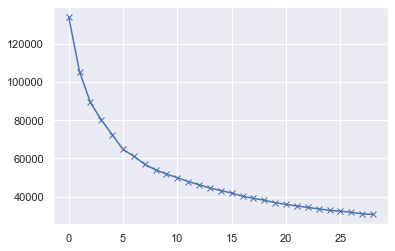

In [21]:
n_clusters=30
cost=[]
for i in range(1,n_clusters):
    kmean= KMeans(i)
    kmean.fit(X)
    cost.append(kmean.inertia_)  

plt.plot(cost, 'bx-')
plt.savefig('../cluster.png')

## Treinando o modelo com 6 clusters

In [22]:
kmean= KMeans(6)
kmean.fit(X)
labels=kmean.labels_

In [23]:
# Concatenando o dataframe com as atribuições de cluster para cada observação
clusters=pd.concat([df_copy, pd.DataFrame({'cluster':labels})], axis=1)
clusters.head()

,TENURE,BALANCE_RANGE,PURCHASES_RANGE,ONEOFF_PURCHASES_RANGE,INSTALLMENTS_PURCHASES_RANGE,CASH_ADVANCE_RANGE,CREDIT_LIMIT_RANGE,PAYMENTS_RANGE,MINIMUM_PAYMENTS_RANGE,BALANCE_FREQUENCY_RANGE,PURCHASES_FREQUENCY_RANGE,ONEOFF_PURCHASES_FREQUENCY_RANGE,PURCHASES_INSTALLMENTS_FREQUENCY_RANGE,CASH_ADVANCE_FREQUENCY_RANGE,PRC_FULL_PAYMENT_RANGE,cluster
0,12,1,1,0,1,0,2,1,1,1,1,0,1,0,0,0
1,12,4,0,0,0,5,5,4,4,1,0,0,0,1,1,1
2,12,4,2,2,0,0,5,2,2,1,1,1,0,0,0,2
3,12,4,4,4,0,1,5,0,1,1,1,1,0,1,0,2
4,12,2,1,1,0,0,4,2,1,1,1,1,0,0,0,2


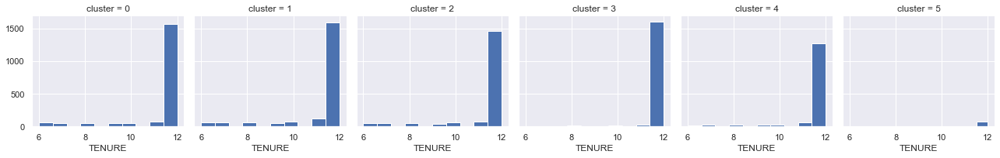

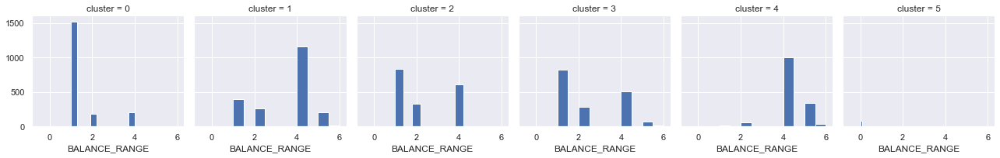

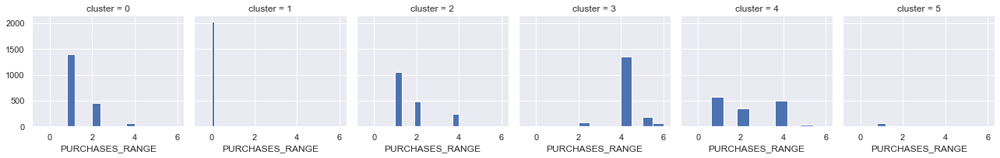

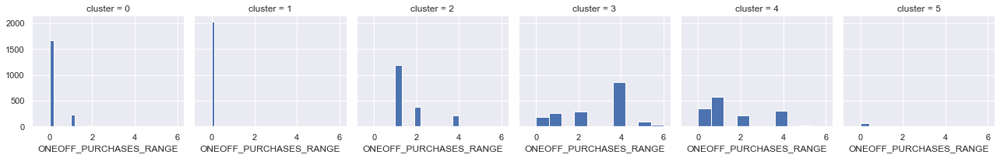

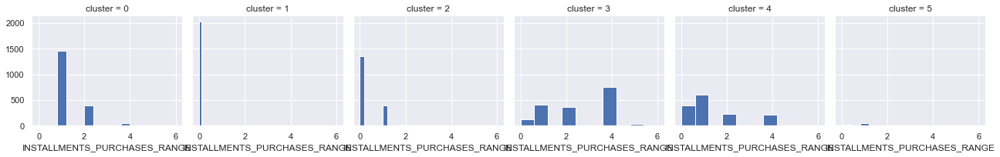

...

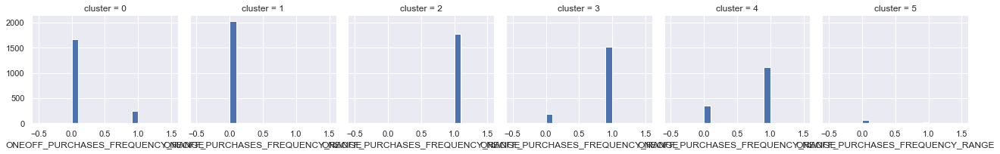

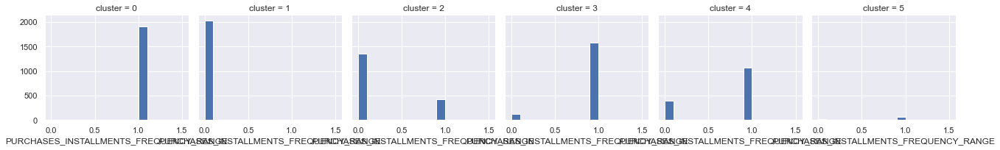

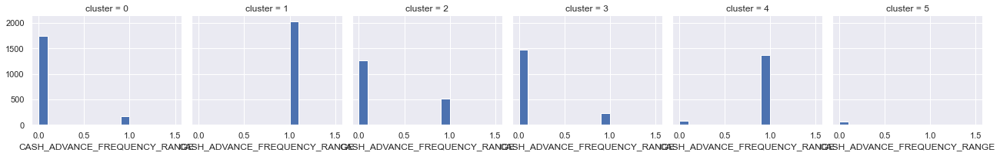

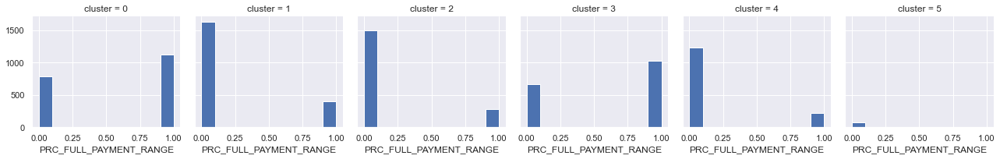

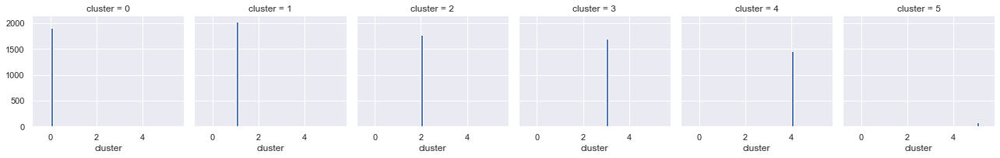

In [24]:
# PLot
i = 0
for c in clusters:
    grid= sns.FacetGrid(clusters, col='cluster')
    grid.map(plt.hist, c)
    plt.savefig(f'../clusters{i}.png')
    i += 1

A partir dos gráficos podemos observar algumas caracteristicas:
- **Grupo 0** - Clientes que realizam todo tipo de compra com o cartão (parcelado, à vista).
- **Grupo 1** - Clientes devedores.
- **Grupo 2** - Clientes que compram a prazo com maior frequência.
- **Grupo 3** - Clientes que usam Cash in Advance (antecipar o dinheiro).
- **Grupo 4** - Clientes que possuem os maiores valores de compra.
- **Grupo 5** - Clientes que não gastam muito

## PCA

- Para reduzir a dimensionalidade vamos utilizar o PCA. Será utilizado 2 dimensões

In [25]:
dist = 1 - cosine_similarity(X)

pca = PCA(2)
pca.fit(dist)
X_PCA = pca.transform(dist)

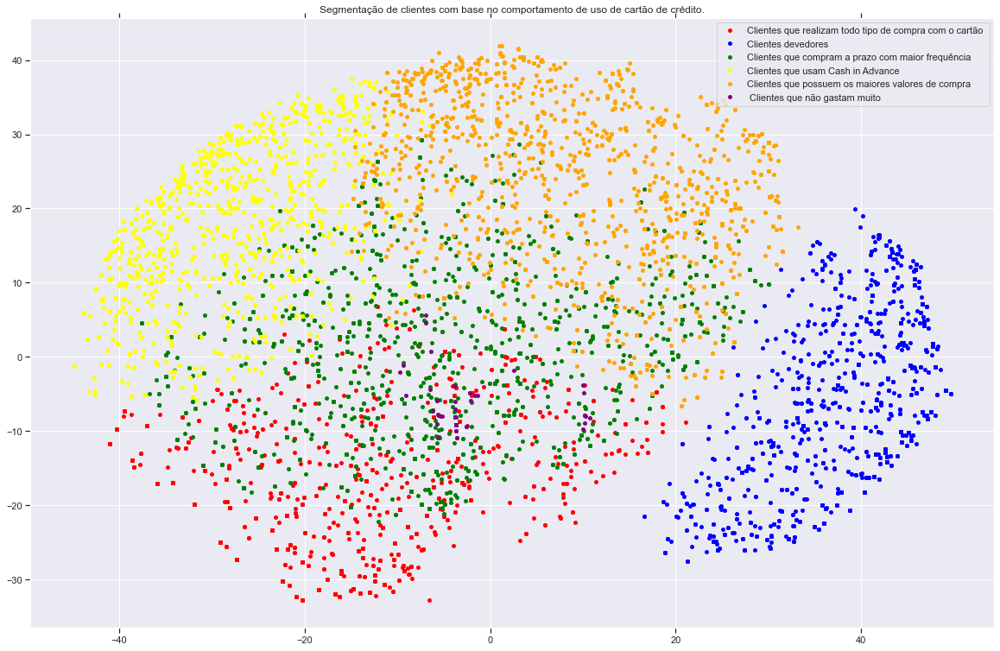

In [26]:
x, y = X_PCA[:, 0], X_PCA[:, 1]

colors = {0: 'red',
          1: 'blue',
          2: 'green', 
          3: 'yellow', 
          4: 'orange',  
          5:'purple'}

names = {0: 'Clientes que realizam todo tipo de compra com o cartão ', 
         1: 'Clientes devedores', 
         2: 'Clientes que compram a prazo com maior frequência', 
         3: 'Clientes que usam Cash in Advance', 
         4: 'Clientes que possuem os maiores valores de compra',
         5: ' Clientes que não gastam muito'}
  
df = pd.DataFrame({'x': x, 'y':y, 'label':labels}) 
groups = df.groupby('label')

fig, ax = plt.subplots(figsize=(20, 13)) 

for name, group in groups:
    ax.plot(group.x, group.y, marker='o', linestyle='', ms=5,
            color=colors[name],label=names[name], mec='none')
    ax.set_aspect('auto')
    ax.tick_params(axis='x',which='both',bottom='off',top='off',labelbottom='off')
    ax.tick_params(axis= 'y',which='both',left='off',top='off',labelleft='off')
    
ax.legend()
ax.set_title("Segmentação de clientes com base no comportamento de uso de cartão de crédito.")
plt.show()

In [27]:
# Criando nova coluna no dataframe original com o resultado final
df_raw['CLUSTER'] = clusters['cluster']
df_raw.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,CLUSTER
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,2
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12,2
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,2


In [28]:
# Exportado para csv
df_raw.to_csv('./input/CC GENERALC.csv', sep=';')